In [1]:
import numpy as np
from matplotlib import pyplot as plt
import csv

%matplotlib inline

import xarray as xr
import lib_ecofun as lef
from importlib import reload
reload(lef)
from scipy.optimize import curve_fit, minimize

In [2]:
fcu = 0.5
inicond = lef.inicond_yr(2000)
inicond['Kf_ini'] = inicond['Kf_ini']*lef.fossil_capacity_util/fcu

params = lef.default_params.copy()

In [3]:
inicond

{'Y_ini': 1, 'Kg_ini': array(0.07815846), 'Kf_ini': 1.84368309}

In [4]:
obs = dict()
#obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
obs['Eg_ratio'] = lef.Eg_ratio#.sel(year = slice(2015, None))

In [5]:
Ef_ini = fcu*lef.inicond_yr(2000)['Kf_ini']
Pf_ini = params['gamma_f'] * (Ef_ini - params['eta_f'] * Ef_ini**params['h_f'])


In [6]:
# obs['Pf'] = (lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean()/Pf_ini
# obs['Pf'].plot()

In [7]:
parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

params:  {'growth': 0.029, 'eps': 1, 'a': 0.9485476302397048, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.13535614331660248, 'beta_0': -0.381223680519475, 'delta_sig': 0.3997116863087387, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.06     -0.22      0.07      0.93      0.01      0.37      0.00      0.05
params:  {'growth': 0.029, 'eps': 1, 'a': 0.9485476302397048, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.13535614331660248, 'beta_0': -0.381223680519475, 'delta_sig': 0.3997116863087387, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.07     -0.21      0.08      0.95      0.01      0.38      0.00      0.05
params:  {'growth': 0.029, 'eps': 1, 'a': 0.9485476302397048, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.13535614331660248, 'beta_0': -0.381223680519475, 'delta_sig': 0.3

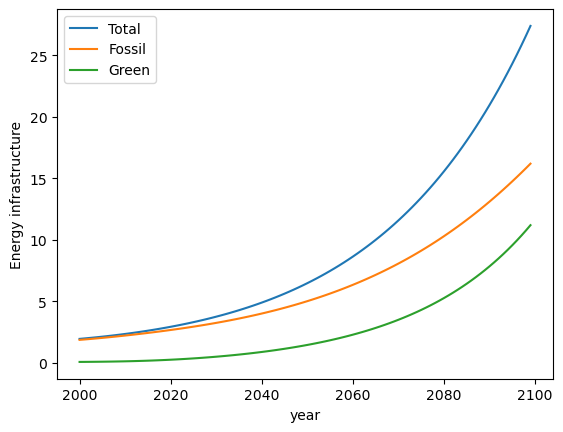

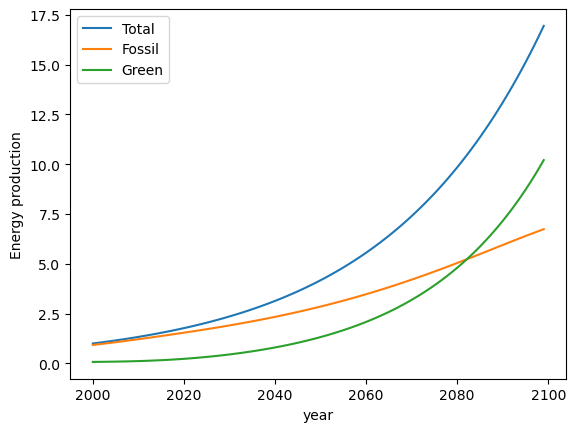

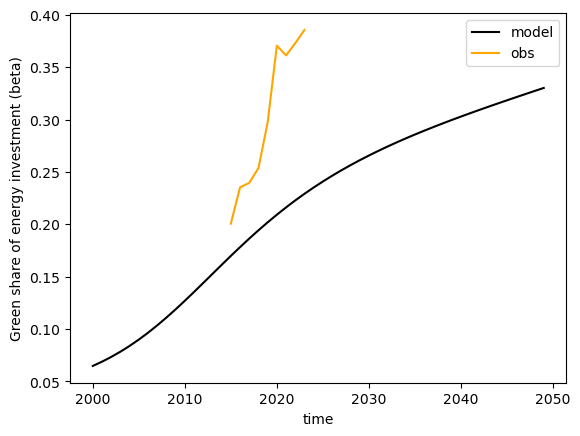

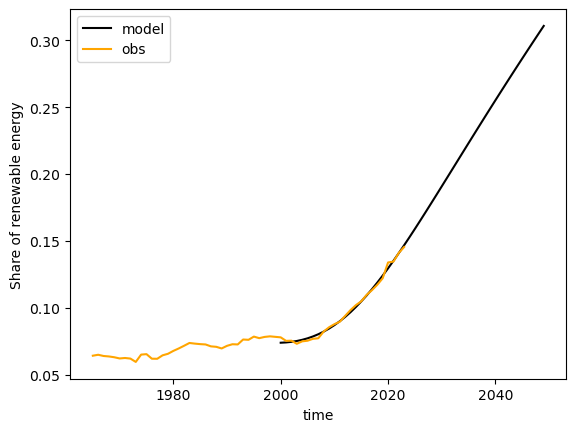

In [8]:
year_ini = 2000

params = lef.default_params.copy()
params['growth'] = 0.029 # fixing Growth!

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
lef.plot_resu(resu_hist, year_ini = year_ini)
lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

In [9]:
E_obs = xr.load_dataarray('Etot_hist_1965-2022.nc')
E_obs /= E_obs.sel(year = 2000)

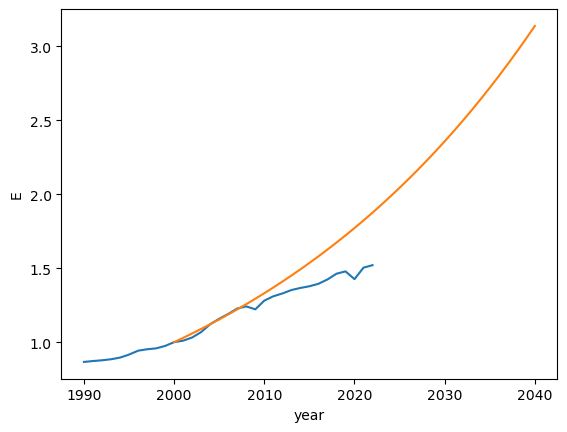

In [10]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

In [11]:
# year_ini = 2000

# linear_gdp = 0.02

# params = lef.default_params.copy()
# params['growth'] = 0.029 # fixing Growth!

# for par, parval in zip(parnames, result.x):
#     params[par] = parval

# resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
# lef.plot_resu(resu_hist, year_ini = year_ini)
# lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

# yini = year_ini
# #print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

# cost = lef.costfun(resu_hist, obs)#, weights = weights)
# print(cost)

In [12]:
1.06**20

3.207135472212848

In [13]:
# (lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
# (resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

In [14]:
# resu_hist.Pf.plot()


### FIT with E_obs and Eg_ratio

In [15]:
obs['E'] = E_obs

In [16]:
# parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
# initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
# bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

parnames = ['growth', 'beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.02, 0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(0.001, 0.05), (-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
#params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

In [17]:
for par, val in zip(parnames, result.x):
    print(par, val)

growth 0.02094179462398636
beta_0 0.10283706436883215
r_inv 0.045645557657893195
a 0.9465846438996682
delta_sig 0.12713780721853574


params:  {'growth': 0.02094179462398636, 'eps': 1, 'a': 0.9465846438996682, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.045645557657893195, 'beta_0': 0.10283706436883215, 'delta_sig': 0.12713780721853574, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.16     -0.23      0.07      0.93      0.01      0.37      0.00      0.01
Fossil infrastructure decreasing! 0.014369162185235304 < 0.018436830900000003
params:  {'growth': 0.02094179462398636, 'eps': 1, 'a': 0.9465846438996682, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.045645557657893195, 'beta_0': 0.10283706436883215, 'delta_sig': 0.12713780721853574, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.17     -0.22      0.08      0.95      0.01      0.38      0.00      0.01
Fossil infrastructure decreasing! 0.014556860329451736 < 0.018396154212852355
params:  {'growth': 0.02094179462398636,

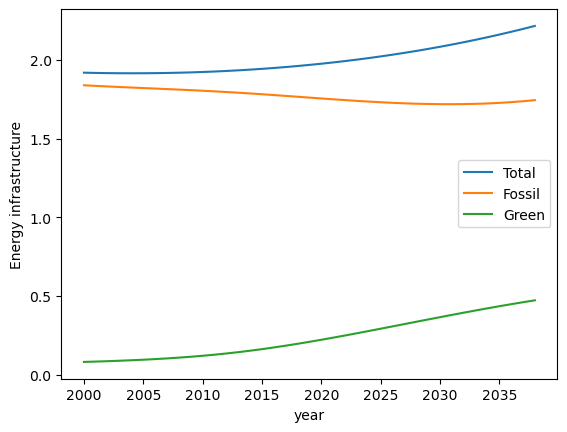

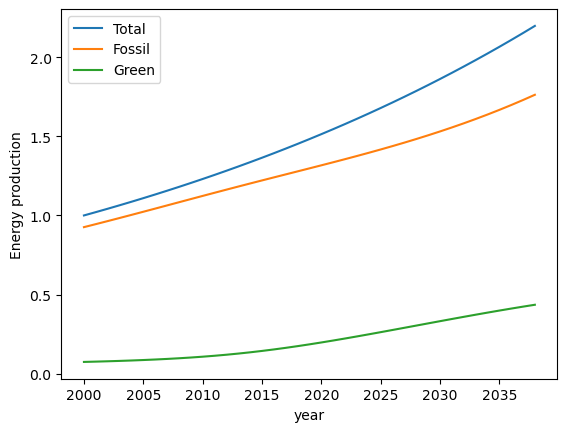

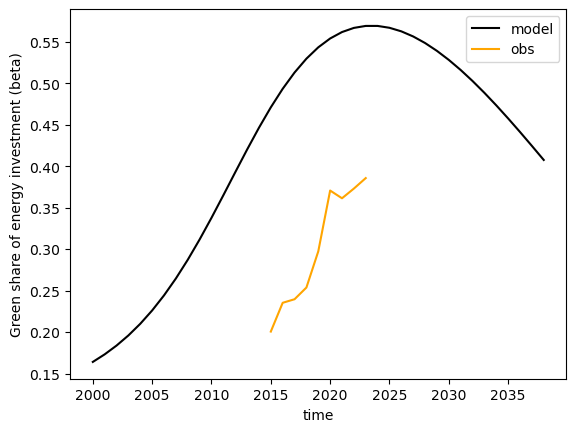

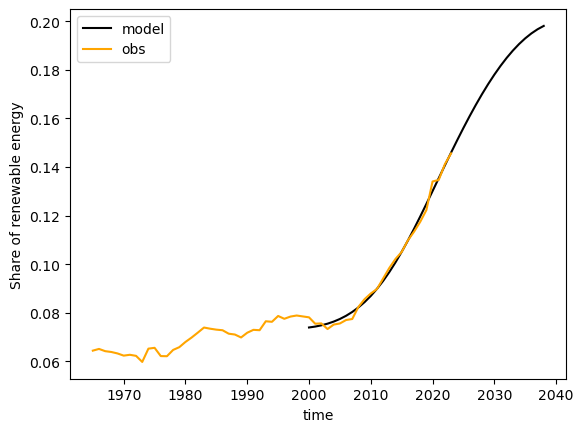

In [18]:
year_ini = 2000

params = lef.default_params.copy()

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
lef.plot_resu(resu_hist, year_ini = year_ini)
lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

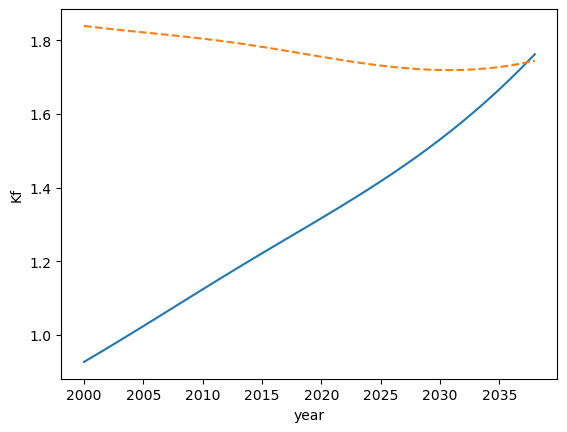

In [19]:
resu_hist.Ef.plot()
(resu_hist.Kf).plot(ls = '--')

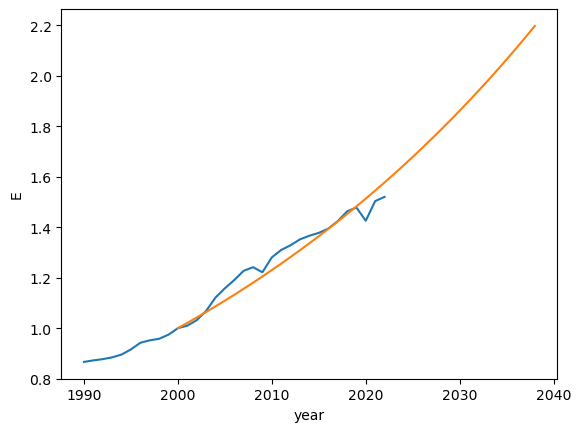

In [20]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

In [21]:
# (lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
# (resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

### WITH FCU = 0.8

In [22]:
fcu = 0.8
inicond = lef.inicond_yr(2000)
inicond['Kf_ini'] = inicond['Kf_ini']*lef.fossil_capacity_util/fcu

In [23]:
# parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
# initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
# bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

parnames = ['growth', 'beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.02, 0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(0.001, 0.03), (-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
#params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, inicond, verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

In [24]:
for par, val in zip(parnames, result.x):
    print(par, val)

growth 0.0209418049925536
beta_0 -0.2831097084724121
r_inv 0.11684169484450775
a 0.9418414596187906
delta_sig 0.47990969261681554


params:  {'growth': 0.0209418049925536, 'eps': 1, 'a': 0.9418414596187906, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.11684169484450775, 'beta_0': -0.2831097084724121, 'delta_sig': 0.47990969261681554, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.07     -0.44      0.07      0.93      0.01      0.37      0.00      0.04
params:  {'growth': 0.0209418049925536, 'eps': 1, 'a': 0.9418414596187906, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.11684169484450775, 'beta_0': -0.2831097084724121, 'delta_sig': 0.47990969261681554, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
check:       0.07     -0.42      0.08      0.95      0.01      0.38      0.00      0.04
params:  {'growth': 0.0209418049925536, 'eps': 1, 'a': 0.9418414596187906, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.11684169484450775, 'be

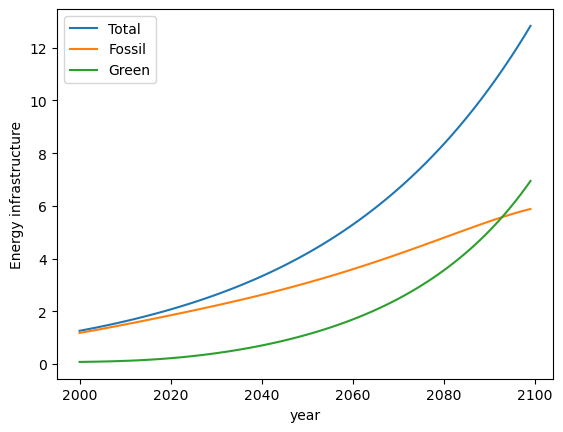

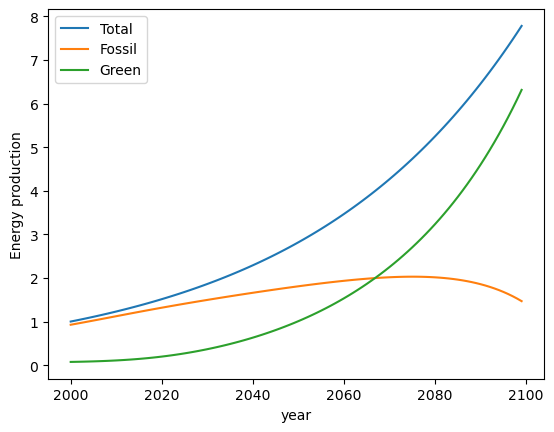

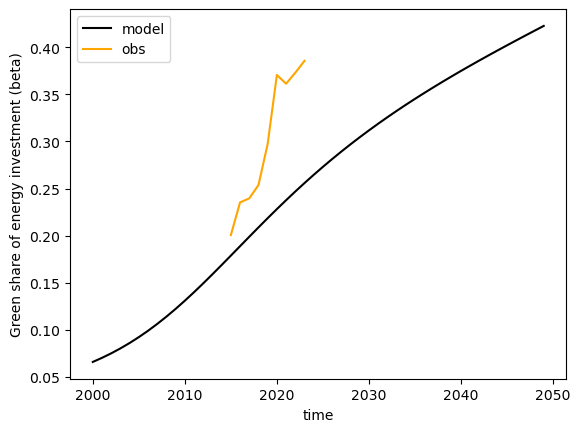

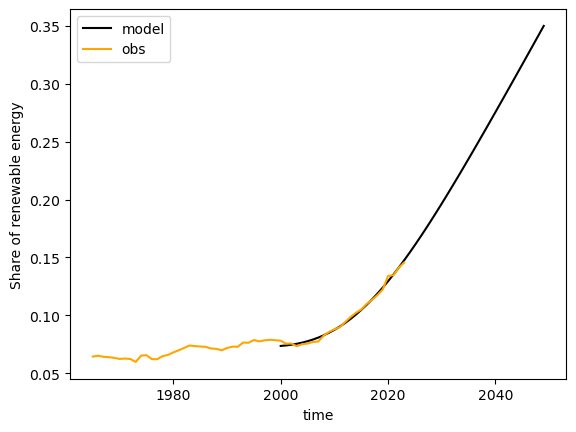

In [25]:
year_ini = 2000

params = lef.default_params.copy()

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = inicond, params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
fig1, fig2 = lef.plot_resu(resu_hist, year_ini = year_ini)
fig3, fig4 = lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

In [26]:
fig1.savefig('figs/energy_infr_fitv2.pdf')
fig2.savefig('figs/energy_prod_fitv2.pdf')
fig3.savefig('figs/fit_energy_inv_share.pdf')
fig4.savefig('figs/fit_energy_prod_share.pdf')
fig4.axes[0].set_xlim((1995, 2030))
fig4.axes[0].set_ylim((0.05, 0.2))
fig4.savefig('figs/fit_energy_prod_share_zoom.pdf')

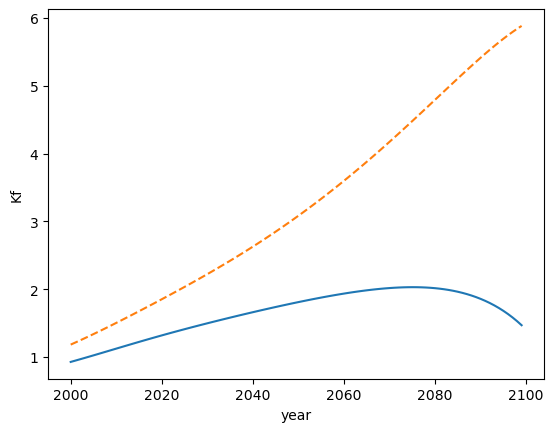

In [27]:
resu_hist.Ef.plot()
(resu_hist.Kf).plot(ls = '--')

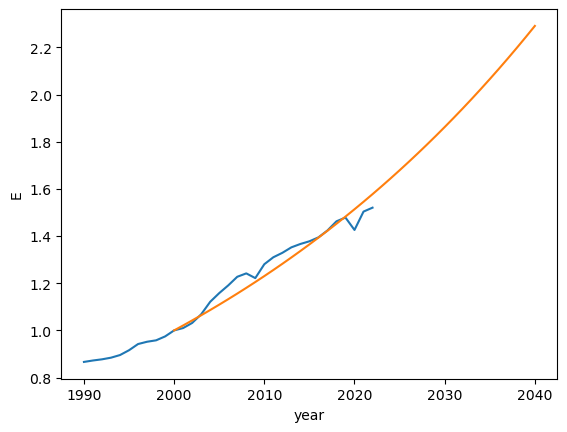

In [28]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

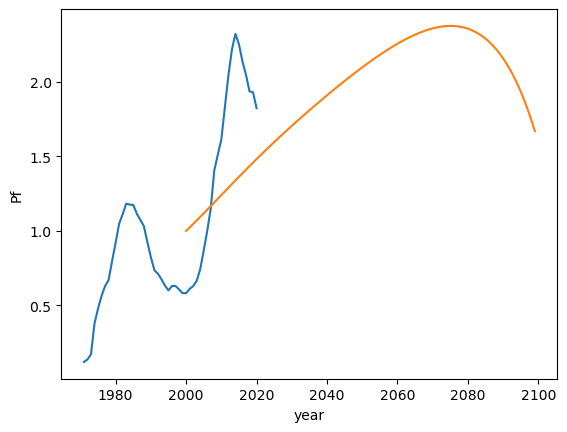

In [29]:
(lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
(resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

In [30]:
co2 = xr.load_dataset('co2_emiss_1750-2022.nc')['co2']

No handles with labels found to put in legend.


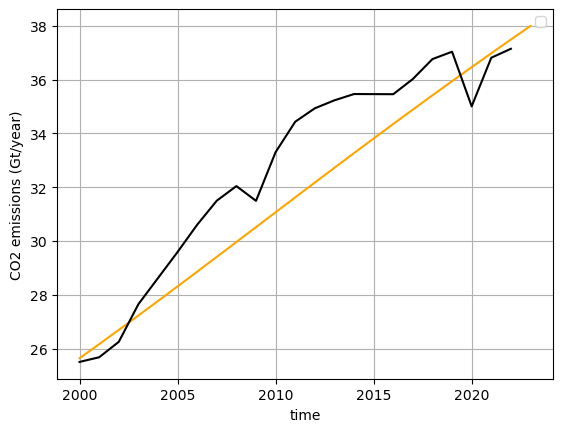

In [31]:
fig = plt.figure()

# for gro, re, col in zip(np.arange(0., 0.06, 0.01), allresu, rainbow_palette[::-1]):
#     lef.to_emissions(re['Ef']).plot(label = f'Growth: {int(100*gro)} %', color = col)

lef.to_emissions(resu_hist['Ef']).sel(year = slice(2000, 2023)).plot(color = 'orange')
co2.sel(year = slice(2000, 2023)).plot(color = 'black')
# lef.Eg_ratio.plot(label = 'obs', color = 'black')

plt.xlabel('time')
plt.ylabel('CO2 emissions (Gt/year)')
plt.legend()
plt.grid()

## Future scenarios

In [32]:
reload(lef)

<module 'lib_ecofun' from '/home/fedef/Research/abstractsepapers/papers/DREAM/codes/lib_ecofun.py'>

In [33]:
year_ini = 2022
inicond = lef.inicond_yr(year_ini)

In [34]:
inicond

{'Y_ini': 1, 'Kg_ini': array(0.14119935), 'Kf_ini': 1.7176013}

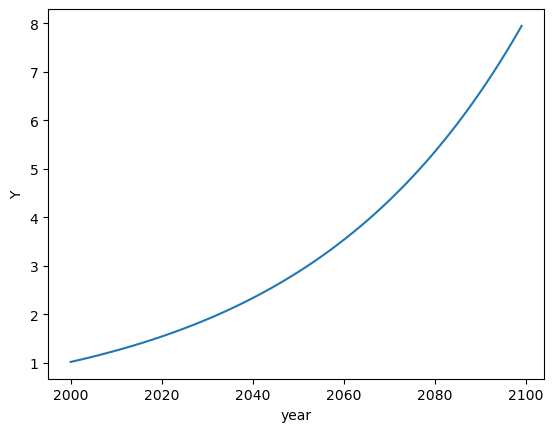

In [35]:
resu_hist.Y.plot()

In [36]:
inicond_hist_2022 = {'Y_ini': resu_hist.sel(year = 2022)['Y'].values, 'Kg_ini': resu_hist.sel(year = 2022)['Kg'].values, 'Kf_ini': resu_hist.sel(year = 2022)['Kf'].values}

In [37]:
inicond_hist_2022

{'Y_ini': array(1.61072987),
 'Kg_ini': array(0.2523456),
 'Kf_ini': array(1.92336915)}

-----------------------
Growth = 0.0
-----------------------
Growth = 0.005
-----------------------
Growth = 0.01
-----------------------
Growth = 0.015
-----------------------
Growth = 0.02
-----------------------
Growth = 0.025
-----------------------
Growth = 0.03
-----------------------
Growth = 0.035
-----------------------
Growth = 0.04


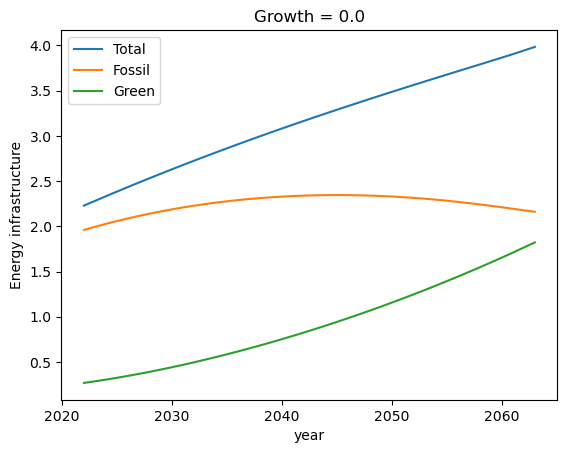

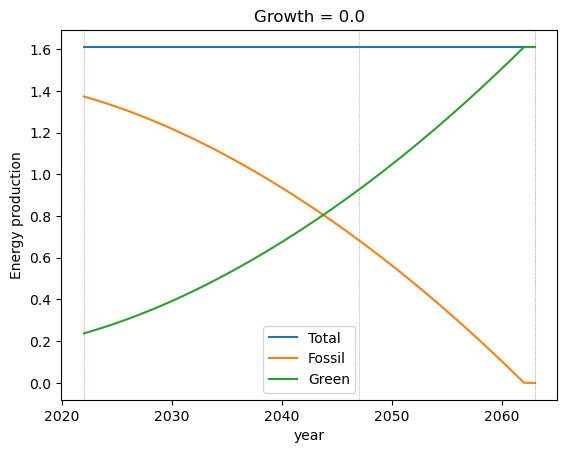

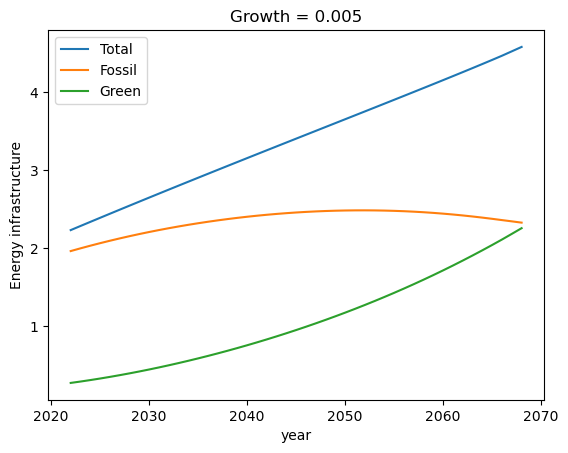

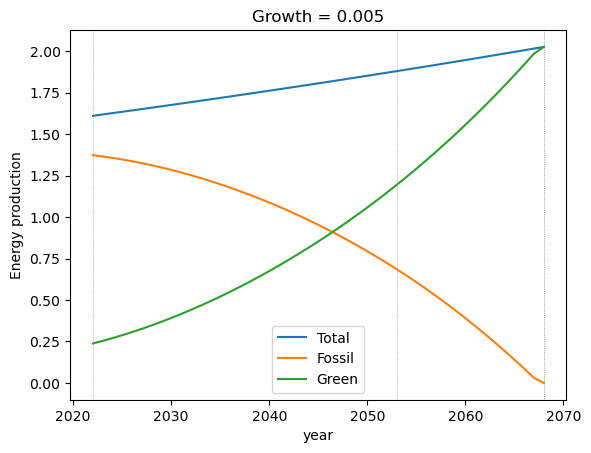

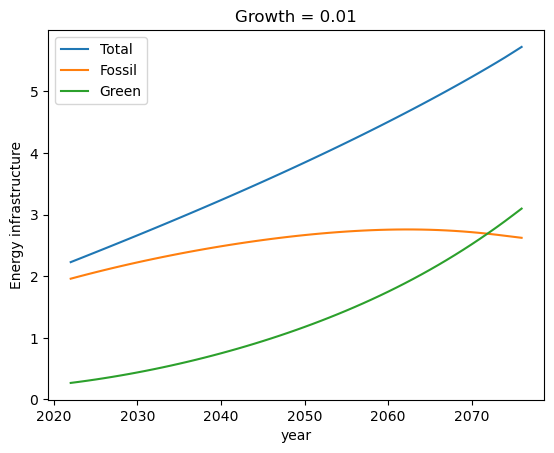

...

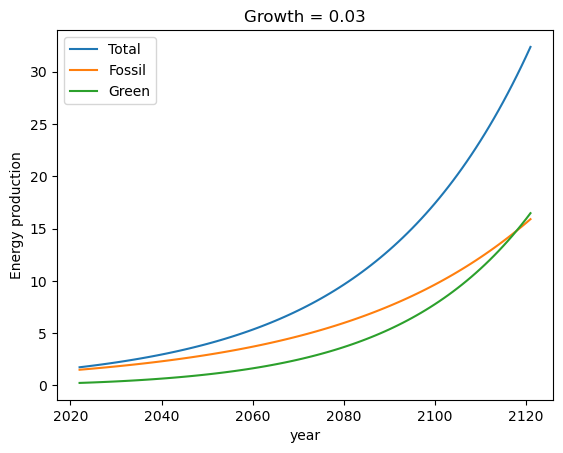

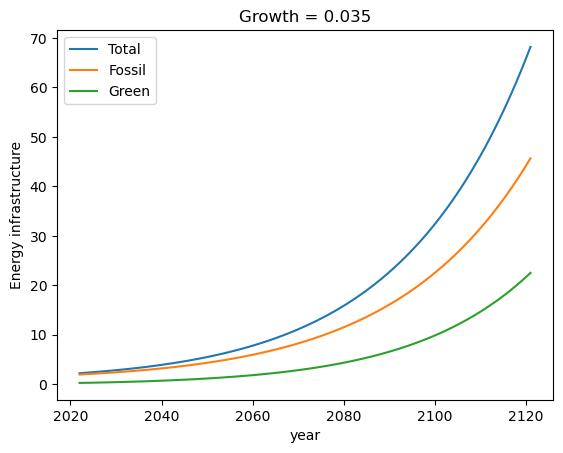

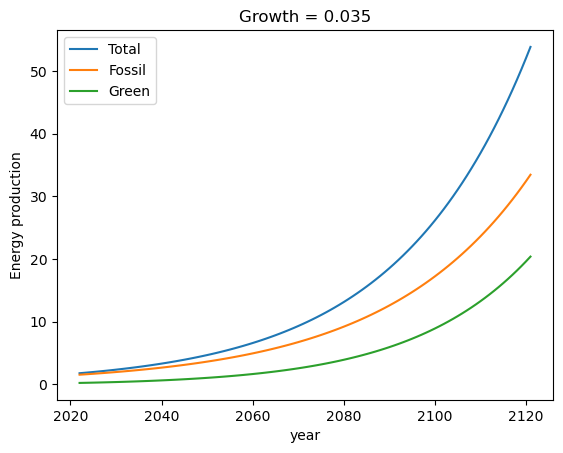

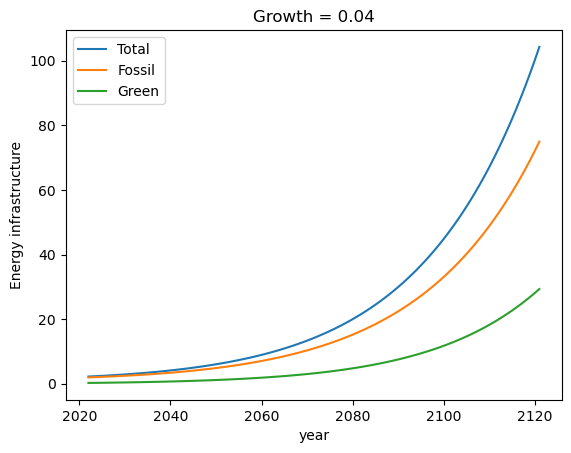

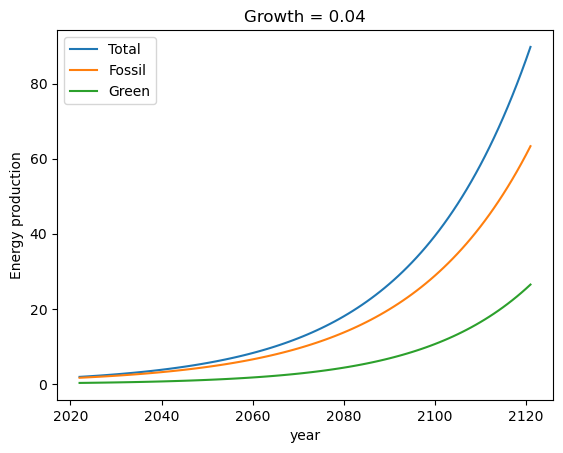

In [38]:
allresu = []

for gro in np.arange(0., 0.041, 0.005):
    params['growth'] = gro
    print('-----------------------')
    print(f'Growth = {gro}')

    resu = lef.run_model(inicond = inicond_hist_2022, params = params, n_iter = 100, verbose = False, rule = 'maxgreen', year_ini = year_ini)
    lef.plot_resu(resu, year_ini = year_ini, title = f'Growth = {gro}')
    allresu.append(resu)

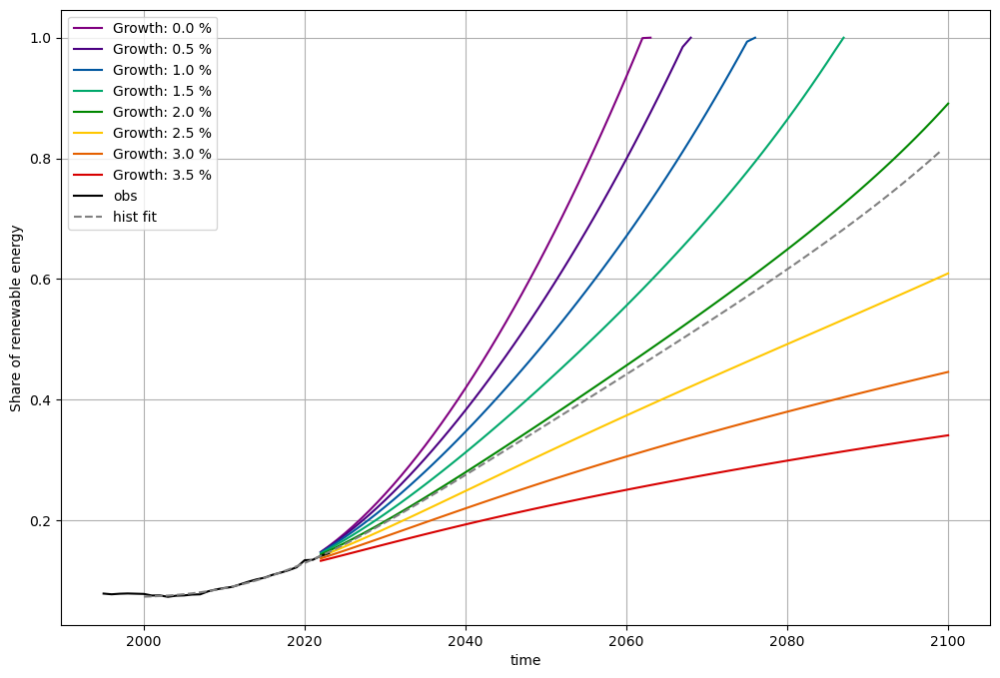

In [39]:
fig = plt.figure(figsize=(12,8))

# rainbow_palette = [
#     "#D70000",  # Dark Red
#     "#E56000",  # Dark Orange
#     "#FFC700",  # Gold
#     "#008700",  # Dark Green
#     "#0057A0",  # Dark Blue
#     "#4B0082"   # Indigo (Dark Purple)
# ]

rainbow_palette = [
    "#D70000",  # Dark Red
    "#E56000",  # Dark Orange
    "#FFC700",  # Gold
    "#008700",  # Dark Green
    "#00A86B",  # Jade Green (New)
    "#0057A0",  # Dark Blue
    "#4B0082",  # Indigo (Dark Purple)
    "#800080"   # Purple (New)
]

for gro, re, col in zip(np.arange(0., 0.041, 0.005), allresu, rainbow_palette[::-1]):
    re['Eg_ratio'].sel(year = slice(None, 2100)).plot(label = f'Growth: {100*gro:.1f} %', color = col)
   
lef.Eg_ratio.sel(year = slice(1995, None)).plot(label = 'obs', color = 'black')
resu_hist['Eg_ratio'].sel(year = slice(None, 2100)).plot(label = f'hist fit', color = 'grey', ls = '--')

plt.xlabel('time')
plt.ylabel('Share of renewable energy')
plt.legend()
plt.grid()

In [40]:
co2 = xr.load_dataset('co2_emiss_1750-2022.nc')['co2']

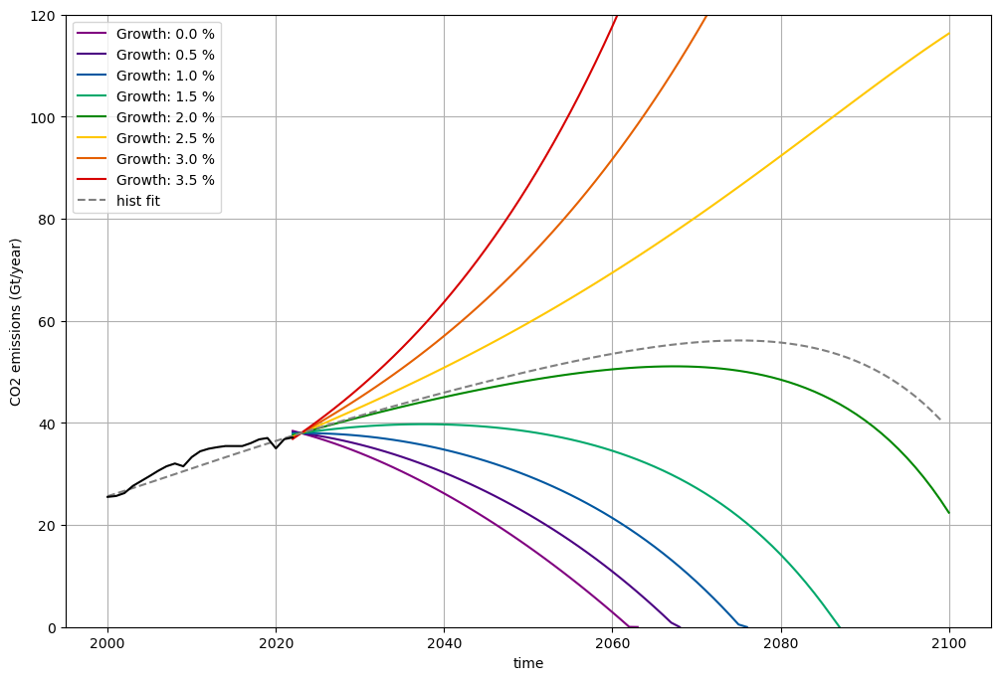

In [42]:
fig = plt.figure(figsize=(12,8))

for gro, re, col in zip(np.arange(0., 0.041, 0.005), allresu, rainbow_palette[::-1]):
    lef.to_emissions(re['Ef']).sel(year = slice(None, 2100)).plot(label = f'Growth: {100*gro:.1f} %', color = col)

fig.axes[0].set_ylim(0, 120)

lef.to_emissions(resu_hist['Ef']).sel(year = slice(2000, 2100)).plot(color = 'grey', ls = '--', label = 'hist fit')
co2.sel(year = slice(2000, 2024)).plot(color = 'black')
# lef.Eg_ratio.plot(label = 'obs', color = 'black')

plt.xlabel('time')
plt.ylabel('CO2 emissions (Gt/year)')
plt.legend()
plt.grid()

fig.savefig('figs/future_scenarios_growth.pdf')

### Read carbon intensity of energy production

In [176]:
import pandas as pd
import xarray as xr
import os

# Get the directory of the current script
# script_dir = os.path.dirname(os.path.abspath(__file__))  # Absolute path of script
script_dir = os.getcwd()

# Construct the full path to the file (assuming it's in the same directory)
filenames = [os.path.join(script_dir, "../data/{}".format(fin)) for fin in ['co2-by-source/co2-by-source.csv', 'co2-per-unit-energy/co2-per-unit-energy.csv', 'energy_per_fuel/global-energy-substitution.csv']]

##########################################################################################

fi = filenames[0]
vnames = ['oil', 'coal', 'gas']
okke = ['Entity', 'Year'] + ['Annual CO2 emissions from {}'.format(ff) for ff in vnames]

# Read CSV and select relevant columns
df = pd.read_csv(fi)#, usecols = okke)
df.columns = df.columns.str.replace('₂', '2')

# # Keep only the first (Country), third (Year), and fourth (Value) columns
# df = df.iloc[:, [0, 2, 3]]
# df.columns = ["Country", "Year", "Value"]  # Rename for clarity

# Convert Year column to integer if necessary
df["Year"] = df["Year"].astype(int)

# Create dictionary with countries as keys and DataArray as values
country_dict = {}
for country, group in df.groupby("Entity"):
    # Convert the group into a Dataset with 'Year' as the dimension
    ds = xr.Dataset(
        {var: ("Year", group['Annual CO2 emissions from {}'.format(var)].values) for var in vnames},
        coords={"Year": group["Year"].values},
    )

    country_dict[country] = ds

co2em = country_dict["World"]

##########################################################################################

fi = filenames[2]
vnames = ['Oil', 'Coal', 'Gas']
okke = ['Entity', 'Year'] + ['{} (TWh, substituted energy)'.format(ff) for ff in vnames]

# Read CSV and select relevant columns
df = pd.read_csv(fi, usecols = okke)

# # Keep only the first (Country), third (Year), and fourth (Value) columns
# df = df.iloc[:, [0, 2, 3]]
# df.columns = ["Country", "Year", "Value"]  # Rename for clarity

# Convert Year column to integer if necessary
df["Year"] = df["Year"].astype(int)

# Create dictionary with countries as keys and DataArray as values
country_dict_eneff = {}
for country, group in df.groupby("Entity"):
    # Convert the group into a Dataset with 'Year' as the dimension
    ds = xr.Dataset(
        {var.lower(): ("Year", group['{} (TWh, substituted energy)'.format(var)].values) for var in vnames},
        coords={"Year": group["Year"].values},
    )

    country_dict_eneff[country] = ds

ene_ff = country_dict_eneff["World"]


In [ ]:
ene_ff

NameError: name 'ene_ff' is not defined

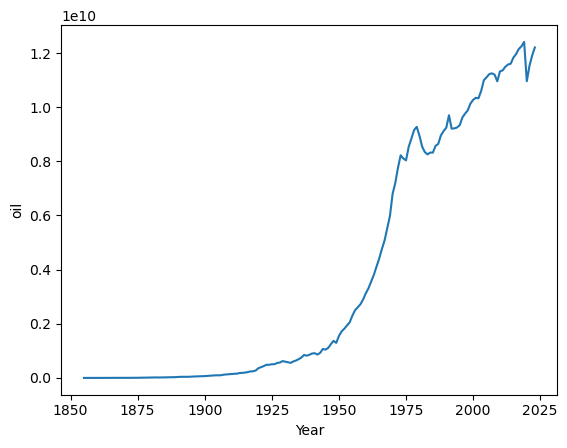

In [178]:
co2em.oil.plot()

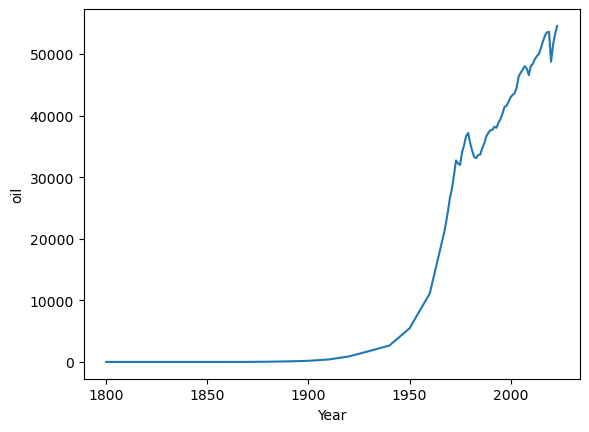

In [179]:
ene_ff.oil.plot()

In [181]:
co2_per_ene = co2em/ene_ff

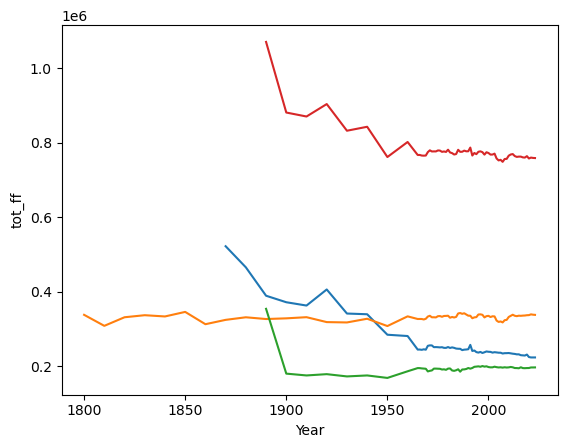

In [186]:
co2_per_ene.oil.plot()
co2_per_ene.coal.plot()
co2_per_ene.gas.plot()

co2_per_ene['tot_ff'] = co2_per_ene.oil+co2_per_ene.gas+co2_per_ene.coal
co2_per_ene.tot_ff.plot()